In [1]:
from pathlib import Path

import pandas as pd
import numpy as np
import datetime as dt

import plotly.express as px
import plotly.io as pio
import matplotlib.pyplot as plt
import seaborn as sns

from ray import tune
from ray.air import session
from ray.train import Checkpoint

from recsys4daos.utils.notebooks import download_plotly, download_matplotlib
import paths

pio.templates.default = 'seaborn'
sns.set_theme()

In [2]:
SPLITS_FREQ = 'W-THU'
SPLITS_NORMALIZE = True # Wether or not to move everything to 00:00
CUTOFF_DATE = dt.datetime.fromisoformat("2023-07-29")
RAY_RESULTS_PATH = '~/ray_results3.11'
ORG_NAME = 'Decentraland'
LAST_FOLDS = 10 # Used for asserts
LAST_FOLD_DATE_STR: str = '2023-07-13'

OPTIM_METRIC = 'map@10'
OPTIM_MODE = 'max'

SAMPLES_PER_SPLIT: int = 100 # See 07_microsoft_tuning.ipynb

In [3]:
# Parameters
EXECUTION_ID = "2024-09-04T10:00"
MAX_BATCH_SIZE = 9
GPUS = 32
ORG_NAME = "DEAD FoundationsDAO"
SPLITS_FREQ = "2d"
LAST_FOLDS = 20
SPLITS_NORMALIZE = True
LAST_FOLD_DATE_STR = "2021-11-28"


In [4]:
RAY_RESULTS_PATH = Path(RAY_RESULTS_PATH).expanduser()
assert RAY_RESULTS_PATH.is_dir()

## Get ray results

In [5]:
fname_glob = paths.lightgcn_ray_tune_fname(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, OPTIM_METRIC, fold='glob')
fname_glob

'DEAD FoundationsDAO/LightGCN_2d_normalize_map@10_fold=[0-9]*'

In [6]:
last_experiments = sorted(RAY_RESULTS_PATH.glob(fname_glob))
print(f"Found {len(last_experiments)} folds")

class TrainLightGCN:
    def __init__(self):
        raise NotImplementedError

tuners = [ tune.Tuner.restore(str(l), TrainLightGCN) for l in last_experiments ]
result_grids = [ tuner.get_results() for tuner in tuners ]
assert len(result_grids) == LAST_FOLDS, f"Waiting for full experiment to run {len(result_grids)}/{LAST_FOLDS}"

for i, rg in enumerate(result_grids):
    print(f"Fold: {i}, {rg.num_terminated} finished, {rg.num_errors} errors")
    assert rg.num_terminated == SAMPLES_PER_SPLIT
    assert rg.num_errors == 0, "There should be no errors"

Found 20 folds


Fold: 0, 100 finished, 0 errors
Fold: 1, 100 finished, 0 errors
Fold: 2, 100 finished, 0 errors
Fold: 3, 100 finished, 0 errors
Fold: 4, 100 finished, 0 errors
Fold: 5, 100 finished, 0 errors
Fold: 6, 100 finished, 0 errors
Fold: 7, 100 finished, 0 errors
Fold: 8, 100 finished, 0 errors
Fold: 9, 100 finished, 0 errors
Fold: 10, 100 finished, 0 errors
Fold: 11, 100 finished, 0 errors
Fold: 12, 100 finished, 0 errors
Fold: 13, 100 finished, 0 errors
Fold: 14, 100 finished, 0 errors
Fold: 15, 100 finished, 0 errors
Fold: 16, 100 finished, 0 errors
Fold: 17, 100 finished, 0 errors
Fold: 18, 100 finished, 0 errors
Fold: 19, 100 finished, 0 errors


In [7]:
# Checking data from just one experiment
pd.concat(result_grids[0]._experiment_analysis.trial_dataframes.values())

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,node_ip,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,9,5,0.006813,6.750507e-03,0.000062,0.25,0.25,0.25,0.25,0.75,...,147.96.81.131,0.345092,1,6,8,1,0.6506,5.897727e-07,21d,2021-10-21T00:00:00
1,9,10,0.000091,1.195085e-07,0.000091,0.00,0.00,0.00,0.00,0.50,...,147.96.81.131,0.495267,2,6,8,1,0.6506,5.897727e-07,21d,2021-10-21T00:00:00
2,9,15,0.000129,2.272701e-05,0.000107,0.00,0.00,0.00,0.00,0.50,...,147.96.81.131,0.645092,3,6,8,1,0.6506,5.897727e-07,21d,2021-10-21T00:00:00
3,9,20,0.000110,3.037942e-12,0.000110,0.00,0.00,0.00,0.00,0.50,...,147.96.81.131,0.793883,4,6,8,1,0.6506,5.897727e-07,21d,2021-10-21T00:00:00
4,9,25,0.000114,3.791324e-06,0.000110,0.00,0.00,0.00,0.00,0.50,...,147.96.81.131,0.940238,5,6,8,1,0.6506,5.897727e-07,21d,2021-10-21T00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,9,180,0.000414,4.089665e-04,0.000005,0.25,0.25,0.25,0.25,0.75,...,147.96.81.131,5.815213,36,9,52,1,0.0070,2.760719e-07,21d,2021-10-21T00:00:00
36,9,185,0.000357,3.516885e-04,0.000005,0.25,0.25,0.25,0.25,0.75,...,147.96.81.131,5.968644,37,9,52,1,0.0070,2.760719e-07,21d,2021-10-21T00:00:00
37,9,190,0.000430,4.250646e-04,0.000005,0.25,0.25,0.25,0.25,0.75,...,147.96.81.131,6.122387,38,9,52,1,0.0070,2.760719e-07,21d,2021-10-21T00:00:00
38,9,195,0.000588,5.832688e-04,0.000005,0.25,0.25,0.25,0.25,0.75,...,147.96.81.131,6.277122,39,9,52,1,0.0070,2.760719e-07,21d,2021-10-21T00:00:00


## Create dataframe with all results

In [8]:
# Read dataframe and drop some unneeded columns
# rdf = pd.concat([rg.get_dataframe(TARGET, 'max') for rg in result_grids ])
rdf = pd.concat([ pd.concat(rg._experiment_analysis.trial_dataframes.values()) for rg in result_grids ])

drop_cols = [
    'timestamp', 'node_ip', 'pid', 'hostname', 'time_since_restore', # 'checkpoint_dir_name', 'trial_id', # 'logdir'
    'model_recall', 'model_ndcg', 'model_precision', 'model_map', 
    'time_train', 'time_eval', 'time_total_s', 'time_this_iter_s',
    'training_iteration', 'iterations_since_restore',
    # 'recall@5', 'map@5', 'recall@10', 'map@10',
]
rdf = rdf.drop(columns=drop_cols)
rdf = rdf.drop(columns=['date']).rename(columns={'config/__trial_index__': 'config/fold', 'iteration':'config/iteration'})
rdf['config/fold'] = pd.to_datetime(rdf['config/fold'])
# rdf = rdf[rdf['done']]
print(rdf.columns)

for c in ['config/batch_size']: #, 'config/embedding_dim']:
    rdf[c] = 2**rdf[c]

# rdf[(rdf['config/fold'] >= 1) & (rdf['iteration'] > 10)].sort_values('precision@5').tail()
# Display some results
rdf.sort_values(OPTIM_METRIC).tail()

Index(['real_batch_size', 'config/iteration', 'loss', 'mf_loss', 'emb_loss',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_rec', 'time_total_train', 'time_total_test', 'done', 'trial_id',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_size',
       'config/fold'],
      dtype='object')


,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
35,10,180,0.283517,0.282677,0.000840,1.0,0.333333,0.2,0.1,0.066667,...,4.555685,False,9c1badfc,256,86,3,0.0002,0.000167,30d,2021-10-23
36,10,185,0.308556,0.307696,0.000860,1.0,0.333333,0.2,0.1,0.066667,...,4.680747,False,9c1badfc,256,86,3,0.0002,0.000167,30d,2021-10-23
37,10,190,0.249746,0.248888,0.000858,1.0,0.333333,0.2,0.1,0.066667,...,4.805151,False,9c1badfc,256,86,3,0.0002,0.000167,30d,2021-10-23
23,10,120,0.370529,0.369841,0.000688,1.0,0.333333,0.2,0.1,0.066667,...,3.033358,False,9c1badfc,256,86,3,0.0002,0.000167,30d,2021-10-23
29,10,150,26.104086,0.000000,26.104086,1.0,0.333333,0.2,0.1,0.066667,...,4.018895,False,a7b26917,256,368,2,0.9303,0.001367,30d,2021-10-23


### Define K_RECOMMENDATIONS

In [9]:
K_RECOMMENDATIONS = { int(c.split('@')[1]) for c in rdf.columns if '@' in c }
K_RECOMMENDATIONS

{1, 3, 5, 10, 15, 100}

## Assert that every experiment was completed

In [10]:
_config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

# _s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
# print(_s)

# Cuidado, no es aleatorio sin reemplazamiento, por lo que
# alguna config, por casualidad, puede estar repetida y es necesario
# usar trial_id
_config_cols.append('trial_id')

_s = rdf.groupby(_config_cols).size().groupby('config/fold').size()
print(_s)
assert all(_s == SAMPLES_PER_SPLIT), "Insufficient number of samples" 

config/fold
2021-10-21    100
2021-10-23    100
2021-10-25    100
2021-10-27    100
2021-10-29    100
2021-10-31    100
2021-11-02    100
2021-11-04    100
2021-11-06    100
2021-11-08    100
2021-11-10    100
2021-11-12    100
2021-11-14    100
2021-11-16    100
2021-11-18    100
2021-11-20    100
2021-11-22    100
2021-11-24    100
2021-11-26    100
2021-11-28    100
dtype: int64


## Get total execution time

In [11]:
_config_cols = ['trial_id'] + [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]

last_iteration_time = rdf.groupby(_config_cols)['time_total_train'].max()
print(last_iteration_time)
print("Mean exec time: ", dt.timedelta(seconds=last_iteration_time.mean()))
print("Total exec time:", dt.timedelta(seconds=last_iteration_time.sum()))

trial_id  config/batch_size  config/embedding_dim  config/conv_layers  config/learning_rate  config/l2     config/window_size  config/fold
0013e15a  512                1                     1                   0.0003                9.239560e-03  90d                 2021-11-20      64.654343
0041292b  512                332                   3                   0.4863                2.211585e-03  10YE                2021-11-18      30.962489
006026d5  128                66                    2                   0.0004                9.919162e-07  90d                 2021-11-06      55.200878
0076ec39  64                 23                    1                   0.8187                1.716902e-05  90d                 2021-11-28     305.372882
00daa34b  64                 3                     1                   0.0013                9.803200e-03  60d                 2021-10-21       0.729143
                                                                                                

In [12]:
# Number of iterations
rdf.groupby('trial_id')['config/iteration'].max().describe()

count    2000.000000
mean      197.357500
std        14.392994
min        85.000000
25%       200.000000
50%       200.000000
75%       200.000000
max       200.000000
Name: config/iteration, dtype: float64

## Get baseline data

In [13]:
bdf = paths.load_openpop(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
bdf = bdf[bdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
bdf.mean()

precision@1        0.00000
precision@3        0.00000
precision@5        0.00000
precision@10       0.00000
precision@15       0.00000
precision@100      0.00000
ndcg@1             0.00000
ndcg@3             0.00000
ndcg@5             0.00000
ndcg@10            0.00000
ndcg@15            0.00000
ndcg@100           0.00000
map@1              0.00000
map@3              0.00000
map@5              0.00000
map@10             0.00000
map@15             0.00000
map@100            0.00000
recall@1           0.00000
recall@3           0.00000
recall@5           0.00000
recall@10          0.00000
recall@15          0.00000
recall@100         0.00000
r-precision@1      0.00000
r-precision@3      0.00000
r-precision@5      0.00000
r-precision@10     0.00000
r-precision@15     0.00000
r-precision@100    0.00000
time_eval          0.06918
dtype: float64

In [14]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2022-06-16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.071717
2022-06-18,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.070396
2022-06-20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069299
2022-06-22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069597
2022-06-24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069861
2022-06-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.071567
2022-06-28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069569
2022-06-30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.068110
2022-07-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.068867


(0.0, 1.0)

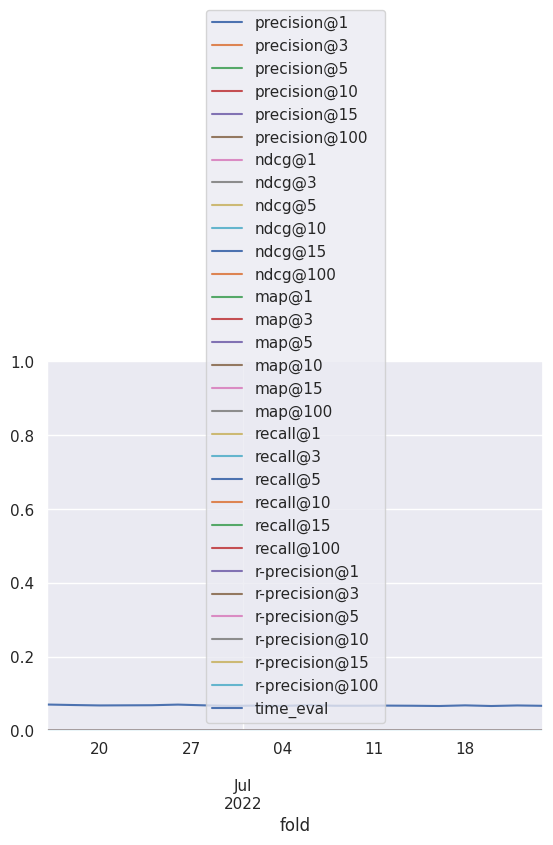

In [15]:
ax = bdf.plot()
ax.set_ylim(0, 1)

### Get perfect data

In [16]:
pdf = paths.load_perfect(ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE)
pdf = pdf[pdf.index <= CUTOFF_DATE][-LAST_FOLDS:]
pdf.mean()

precision@1        0.350000
precision@3        0.350000
precision@5        0.350000
precision@10       0.350000
precision@15       0.326667
precision@100      0.049000
ndcg@1             0.350000
ndcg@3             0.350000
ndcg@5             0.350000
ndcg@10            0.350000
ndcg@15            0.350000
ndcg@100           0.350000
map@1              0.350000
map@3              0.350000
map@5              0.350000
map@10             0.350000
map@15             0.350000
map@100            0.350000
recall@1           0.025000
recall@3           0.075000
recall@5           0.125000
recall@10          0.250000
recall@15          0.350000
recall@100         0.350000
r-precision@1      0.025000
r-precision@3      0.075000
r-precision@5      0.125000
r-precision@10     0.250000
r-precision@15     0.350000
r-precision@100    0.350000
time_eval          0.090936
dtype: float64

In [17]:
pdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2022-06-16,1.0,1.0,1.0,1.0,0.933333,0.14,1.0,1.0,1.0,1.0,...,0.714286,1.0,1.0,0.071429,0.214286,0.357143,0.714286,1.0,1.0,0.127259
2022-06-18,1.0,1.0,1.0,1.0,0.933333,0.14,1.0,1.0,1.0,1.0,...,0.714286,1.0,1.0,0.071429,0.214286,0.357143,0.714286,1.0,1.0,0.124964
2022-06-20,1.0,1.0,1.0,1.0,0.933333,0.14,1.0,1.0,1.0,1.0,...,0.714286,1.0,1.0,0.071429,0.214286,0.357143,0.714286,1.0,1.0,0.124854
2022-06-22,1.0,1.0,1.0,1.0,0.933333,0.14,1.0,1.0,1.0,1.0,...,0.714286,1.0,1.0,0.071429,0.214286,0.357143,0.714286,1.0,1.0,0.124780
2022-06-24,1.0,1.0,1.0,1.0,0.933333,0.14,1.0,1.0,1.0,1.0,...,0.714286,1.0,1.0,0.071429,0.214286,0.357143,0.714286,1.0,1.0,0.126348
2022-06-26,1.0,1.0,1.0,1.0,0.933333,0.14,1.0,1.0,1.0,1.0,...,0.714286,1.0,1.0,0.071429,0.214286,0.357143,0.714286,1.0,1.0,0.126606
2022-06-28,1.0,1.0,1.0,1.0,0.933333,0.14,1.0,1.0,1.0,1.0,...,0.714286,1.0,1.0,0.071429,0.214286,0.357143,0.714286,1.0,1.0,0.124484
2022-06-30,0.0,0.0,0.0,0.0,0.000000,0.00,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.071768
2022-07-02,0.0,0.0,0.0,0.0,0.000000,0.00,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.072021


(0.0, 1.0)

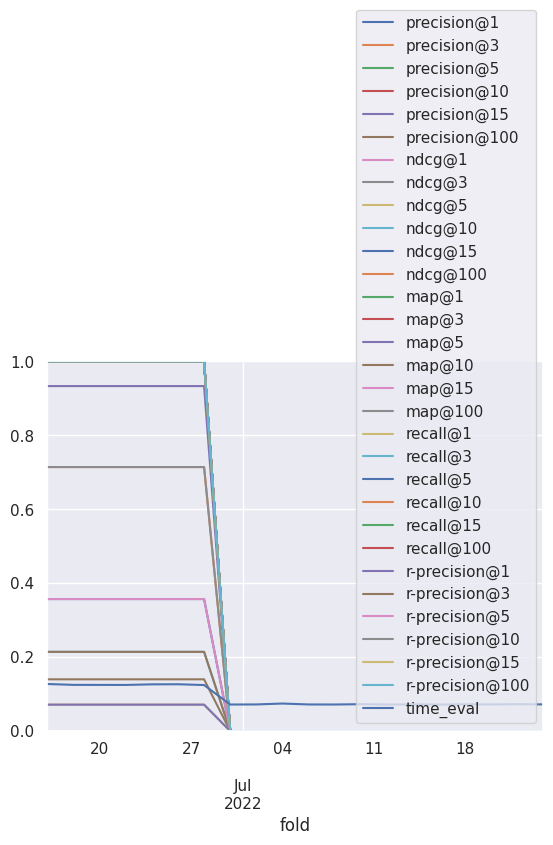

In [18]:
ax = pdf.plot()
ax.set_ylim(0, 1)

## Explore hparams

In [19]:
# Primero, obtenemos la mejor iteración, como si hubiesemos hecho early stopping
hdf = pd.concat(rg.get_dataframe(OPTIM_METRIC, OPTIM_MODE) for rg in result_grids)
print(hdf.columns)
hdf

Index(['real_batch_size', 'iteration', 'loss', 'mf_loss', 'emb_loss',
       'model_recall', 'model_ndcg', 'model_precision', 'model_map',
       'precision@1', 'precision@3', 'precision@5', 'precision@10',
       'precision@15', 'precision@100', 'ndcg@1', 'ndcg@3', 'ndcg@5',
       'ndcg@10', 'ndcg@15', 'ndcg@100', 'map@1', 'map@3', 'map@5', 'map@10',
       'map@15', 'map@100', 'recall@1', 'recall@3', 'recall@5', 'recall@10',
       'recall@15', 'recall@100', 'r-precision@1', 'r-precision@3',
       'r-precision@5', 'r-precision@10', 'r-precision@15', 'r-precision@100',
       'time_eval', 'time_train', 'time_rec', 'time_total_train',
       'time_total_test', 'done', 'training_iteration', 'trial_id', 'date',
       'timestamp', 'time_this_iter_s', 'time_total_s', 'pid', 'hostname',
       'node_ip', 'time_since_restore', 'iterations_since_restore',
       'config/batch_size', 'config/embedding_dim', 'config/conv_layers',
       'config/learning_rate', 'config/l2', 'config/window_siz

,real_batch_size,iteration,loss,mf_loss,emb_loss,model_recall,model_ndcg,model_precision,model_map,precision@1,...,time_since_restore,iterations_since_restore,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold,logdir
0,9,5,0.006813,0.006751,0.000062,0.25,0.25,0.25,0.25,0.7500,...,0.345092,1,6,8,1,0.6506,5.897727e-07,21d,2021-10-21T00:00:00,34e2d2f1
1,33,115,0.347458,0.335149,0.012310,0.00,0.00,0.00,0.00,0.7500,...,3.959844,23,6,1,3,0.4512,1.071885e-03,10YE,2021-10-21T00:00:00,942034dd
2,9,30,0.221233,0.220450,0.000783,0.00,0.00,0.00,0.00,1.0000,...,1.070502,6,7,1,3,0.1008,9.495423e-05,21d,2021-10-21T00:00:00,6c03df91
3,10,5,0.678430,0.677221,0.001209,0.00,0.00,0.00,0.00,0.2500,...,0.327854,1,7,2,4,0.0001,3.971318e-03,30d,2021-10-21T00:00:00,e0487cbd
4,9,5,0.002445,0.000152,0.002293,0.00,0.00,0.00,0.00,0.7500,...,0.335290,1,7,96,2,0.0784,4.924245e-05,21d,2021-10-21T00:00:00,038bc771
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,256,50,0.101334,0.100700,0.000634,0.00,0.00,0.00,0.00,0.0000,...,42.545224,10,8,6,2,0.1278,3.279935e-06,90d,2021-11-28T00:00:00,275921db
96,512,30,0.017324,0.001956,0.015368,0.00,0.00,0.00,0.00,0.0250,...,9.347221,6,9,614,3,0.0202,6.743998e-04,21d,2021-11-28T00:00:00,1cf462a7
97,512,75,0.006314,0.004845,0.001468,0.00,0.00,0.00,0.00,0.0000,...,14.906837,15,9,665,3,0.0092,2.744564e-05,90d,2021-11-28T00:00:00,8161ab60
98,128,15,0.095896,0.095826,0.000070,0.00,0.00,0.00,0.00,0.0125,...,19.022728,3,7,19,1,0.1043,2.502032e-07,30d,2021-11-28T00:00:00,549a0ebf


In [20]:
# Force categorization
hdf['config/fold'] = hdf['config/fold'].astype(str)

fig = px.scatter(hdf, x='map@10', y='ndcg@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [21]:
fig = px.scatter(hdf, x='iteration', y='loss', color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [22]:
fig = px.scatter(hdf, x='iteration', y=OPTIM_METRIC, color='config/fold', log_y=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [23]:
fig = px.scatter(hdf, x='loss', y='ndcg@10', color='config/fold', log_x=True)
fig.layout.update(showlegend=True)

download_plotly(fig, 'scatter_ndcg_map.pdf')
fig

In [24]:
fig = px.scatter(hdf, x='real_batch_size', y='config/window_size', color='config/fold')
fig

In [25]:
fig = px.scatter(hdf, x=OPTIM_METRIC, y='precision@10', color='config/fold')
fig.layout.update(showlegend=False)

download_plotly(fig, 'scatter_map_precision.pdf')
fig

In [26]:
def plotly_scatter_config(config, log=True):
    config_cols = [c for c in hdf.columns if c.startswith('config/') ]
    return px.scatter(hdf, x=config, y=OPTIM_METRIC, color='config/fold', marginal_x='rug', marginal_y='rug', log_x=log, hover_data=config_cols)

plotly_scatter_config('config/embedding_dim')

In [27]:
plotly_scatter_config('config/window_size', log=False)

In [28]:
plotly_scatter_config('config/learning_rate')

In [29]:
plotly_scatter_config('config/l2')

In [30]:
plotly_scatter_config('config/batch_size', log=False)

In [31]:
plotly_scatter_config('config/conv_layers')

In [32]:
def clean_results(df: pd.DataFrame):
    hparams = [ c.removeprefix('config/') for c in df.columns if c.startswith('config/') and c not in ['config/iteration', 'config/fold'] ]
    return (
        df
        .rename(columns=lambda c: c.removeprefix('config/'),)
        .rename(columns={
            'time_total_train': 'time_train',
            'time_total_test': 'time_eval',
            'time_total_rec': 'time_rec',
        })
        .drop(columns=['real_batch_size'])
        .set_index(['fold', *hparams])
    ), hparams

clean_rdf, hparams = clean_results(rdf.copy())
clean_rdf

iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size              
2021-10-21 64         8             1           0.6506        5.897727e-07 21d                  5   
                                                                           21d                 10   
                                                                           21d                 15   
                                                                           21d                 20   
                                                                           21d                 25   
...                                                                                           ...   
2021-11-28 512        2             3           0.0007        1.130950e-05 90d                180   
                                                                           90d                185   
                                                                           90d                190   
                                                                           90d                195   
                                                                           90d                200   

                                                                                            loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size             
2021-10-21 64         8             1           0.6506        5.897727e-07 21d          0.006813   
                                                                           21d          0.000091   
                                                                           21d          0.000129   
                                                                           21d          0.000110   
                                                                           21d          0.000114   
...                                                                                          ...   
2021-11-28 512        2             3           0.0007        1.130950e-05 90d          0.129434   
                                                                           90d          0.133871   
                                                                           90d          0.131568   
                                                                           90d          0.130217   
                                                                           90d          0.125534   

                                                                                             mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size                 
2021-10-21 64         8             1           0.6506        5.897727e-07 21d          6.750507e-03   
                                                                           21d          1.195085e-07   
                                                                           21d          2.272701e-05   
                                                                           21d          3.037942e-12   
                                                                           21d          3.791324e-06   
...                                                                                              ...   
2021-11-28 512        2             3           0.0007        1.130950e-05 90d          1.293662e-01   
                                                                           90d          1.338020e-01   
                                                                           90d          1.314980e-01   
                                                                           90d          1.301462e-01   
                                                                           90d          1.254626e-01   

                                                                                        emb_loss  \
fold       batch_siz

In [33]:
px.scatter(clean_rdf.reset_index(), y='iteration', x='loss', color='fold', log_x=True)

In [34]:
px.scatter(clean_rdf.reset_index(), x='loss', y=OPTIM_METRIC, color='fold', log_x=True)

Letting it run more iterations gets a best loss. But letting it run more does not get a best ndcg or map, as loss and the test results have not a strong correlation.

In [35]:
px.scatter(clean_rdf.reset_index(), y='iteration', x=OPTIM_METRIC, color='fold')

## Choosing best hparams

In [36]:
best_all = clean_rdf.sort_values(OPTIM_METRIC).drop_duplicates('trial_id', keep='last')
paths.save_model_results(best_all, 'lightgcn-all', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best_all

Saved dataframe into /home/daviddavo/recsys4daos/data/output/DEAD FoundationsDAO/models/lightgcn-all_2d_normalize.parquet


iteration  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size              
2021-10-29 128        1             1           0.0010        4.674868e-06 10YE                 5   
           512        8             3           0.0073        2.088313e-04 30d                 25   
           64         18            2           0.0001        9.356654e-04 90d                 80   
           256        876           3           0.0004        4.526288e-03 10YE                45   
           128        143           1           0.0006        4.014858e-07 60d                145   
...                                                                                           ...   
2021-10-23 512        1             2           0.0004        2.721606e-07 90d                 65   
           128        1             2           0.0005        1.043249e-06 90d                  5   
           512        1             1           0.0029        6.990705e-04 21d                105   
           256        86            3           0.0002        1.667490e-04 30d                120   
                      368           2           0.9303        1.366956e-03 30d                150   

                                                                                             loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size              
2021-10-29 128        1             1           0.0010        4.674868e-06 10YE          0.681492   
           512        8             3           0.0073        2.088313e-04 30d           0.018422   
           64         18            2           0.0001        9.356654e-04 90d           0.277172   
           256        876           3           0.0004        4.526288e-03 10YE          0.049673   
           128        143           1           0.0006        4.014858e-07 60d           0.001984   
...                                                                                           ...   
2021-10-23 512        1             2           0.0004        2.721606e-07 90d           0.683897   
           128        1             2           0.0005        1.043249e-06 90d           0.689735   
           512        1             1           0.0029        6.990705e-04 21d           0.383878   
           256        86            3           0.0002        1.667490e-04 30d           0.370529   
                      368           2           0.9303        1.366956e-03 30d          26.104086   

                                                                                         mf_loss  \
fold       batch_size embedding_dim conv_layers learning_rate l2           window_size             
2021-10-29 128        1             1           0.0010        4.674868e-06 10YE         0.681492   
           512        8             3           0.0073        2.088313e-04 30d          0.016768   
           64         18            2           0.0001        9.356654e-04 90d          0.275599   
           256        876           3           0.0004        4.526288e-03 10YE         0.013100   
           128        143           1           0.0006        4.014858e-07 60d          0.001980   
...                                                                                          ...   
2021-10-23 512        1             2           0.0004        2.721606e-07 90d          0.683897   
           128        1             2           0.0005        1.043249e-06 90d          0.689735   
           512        1             1           0.0029        6.990705e-04 21d          0.382797   
           256        86            3           0.0002        1.667490e-04 30d          0.369841   
                      368           2           0.9303        1.366956e-03 30d          0.000000   

                                                                                            emb_loss  \
fold       batch_size embedding_dim conv_layers learnin

### Per fold

In [37]:
# We fix the total time in less than 250 so it has time to do the same number of iterations with the next fold
# best = rdf[rdf['time_total_train'] + rdf['time_total_test'] < 250].sort_values(OPTIM_METRIC).drop_duplicates('config/fold', keep='last').set_index('config/fold').sort_index()
idx = clean_rdf.index.names + ['iteration']
best = clean_rdf.sort_values(OPTIM_METRIC).reset_index().drop_duplicates('fold', keep='last').set_index(idx).sort_index()
paths.save_model_results(best, 'lightgcn-best-val', ORG_NAME, SPLITS_FREQ, SPLITS_NORMALIZE, K_RECOMMENDATIONS)
best

Saved dataframe into /home/daviddavo/recsys4daos/data/output/DEAD FoundationsDAO/models/lightgcn-best-val_2d_normalize.parquet


,,,,,,,,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,...,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_rec,time_train,time_eval,done,trial_id
fold,batch_size,embedding_dim,conv_layers,learning_rate,l2,window_size,iteration,,,,,,,,,,,,,,,,,,,,,
2021-10-21,64,1,2,0.0049,0.004837,21d,150,0.313926,0.296930,0.016995,1.000000,0.333333,0.200000,0.100000,0.066667,0.010000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.001350,0.613888,3.751027,False,f6c729be
2021-10-23,256,368,2,0.9303,0.001367,30d,150,26.104086,0.000000,26.104086,1.000000,0.333333,0.200000,0.100000,0.066667,0.010000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.006778,5.525568,4.018895,False,a7b26917
2021-10-25,512,813,1,0.3900,0.000013,90d,60,0.580885,0.000000,0.580885,0.800000,0.333333,0.200000,0.100000,0.066667,0.010000,0.800000,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.005198,2.668817,1.596289,False,3ad6f193
2021-10-27,128,143,2,0.0056,0.000037,60d,155,0.011432,0.010593,0.000839,0.125000,0.125000,0.125000,0.137500,0.125000,0.146250,0.125000,...,0.023438,0.017995,0.038359,0.052447,0.396271,0.004015,39.432481,6.333618,False,b6f20b58
2021-10-29,128,5,2,0.3681,0.001017,90d,80,0.363908,0.163923,0.199985,0.066667,0.044444,0.026667,0.013333,0.008889,0.007333,0.066667,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.003211,3.521681,2.056407,False,4abdb9e7
2021-10-31,512,1,4,0.8177,0.000028,90d,65,0.247442,0.245958,0.001484,0.000000,0.044118,0.026471,0.014706,0.011765,0.004265,0.000000,...,0.500000,0.500000,0.500000,0.500000,0.500000,0.153334,1.517391,2.519882,False,af53d0a8
2021-11-02,128,452,4,0.1070,0.003669,90d,120,0.612657,0.054580,0.558076,0.142857,0.095238,0.085714,0.071429,0.057143,0.021429,0.142857,...,0.430556,0.541667,0.597222,0.597222,0.597222,0.008856,41.796974,4.530296,False,8f9531f1
2021-11-04,64,3,3,0.0324,0.000335,21d,185,0.044897,0.037086,0.007811,0.150000,0.100000,0.060000,0.060000,0.046667,0.015500,0.150000,...,0.633333,0.633333,0.666667,0.666667,0.666667,0.003483,77.450513,5.527705,False,7eaec384
2021-11-06,512,7,2,0.3292,0.000002,21d,130,0.545533,0.543122,0.002411,0.166667,0.129630,0.088889,0.072222,0.062963,0.017778,0.166667,...,0.600000,0.633333,0.666667,0.666667,0.666667,0.002473,11.254465,3.540071,False,0580c271


,precision@5,map@10
count,20.000000,20.000000
mean,0.081643,0.279244
std,0.060046,0.322483
min,0.018868,0.043322
25%,0.031385,0.064317
50%,0.073678,0.156237
75%,0.102160,0.304361
max,0.200000,1.000000


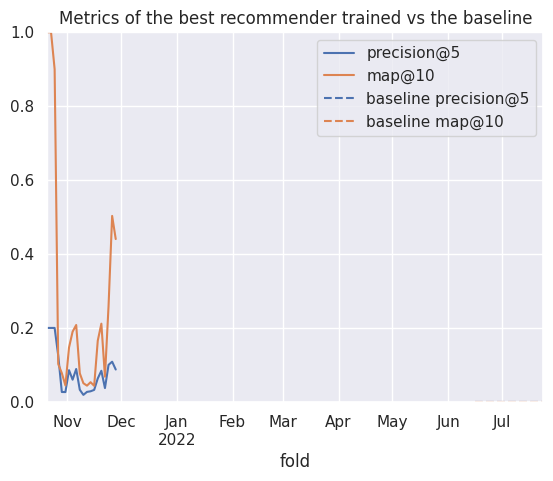

In [38]:
cols2plot = ['precision@5', 'map@10']

ax = best.reset_index().set_index('fold')[cols2plot].plot()
ax.set_ylim(0, 1)

bdf[cols2plot].rename(columns='baseline {}'.format).plot(ax=ax, style='--', color=[l.get_color() for l in ax.lines])

plt.title("Metrics of the best recommender trained vs the baseline")
best[cols2plot].describe()

In [39]:
best[['precision@5', 'ndcg@5', 'precision@10', 'ndcg@10', 'map@5', 'map@10']].mean()

precision@5     0.081643
ndcg@5          0.293669
precision@10    0.053631
ndcg@10         0.306444
map@5           0.273831
map@10          0.279244
dtype: float64

## Realisitc model (repeating hparams)

In [40]:
from pandas.api.types import is_float_dtype

config_cols = [ c for c in rdf.columns if c.startswith('config/') and c != 'config/iteration' ]
config_cols2 = config_cols + ['config/iteration']

all_configs = rdf.copy()
display(all_configs)
all_configs['config/fold'] = (pd.to_datetime(all_configs['config/fold']) + pd.tseries.frequencies.to_offset(SPLITS_FREQ)) # .astype(str)

# Leonardo Torres de Quevedo, perdoname por lo que voy a hacer
float_cols = [c for c in config_cols if is_float_dtype(all_configs[c].dtype) ]
all_configs[float_cols] = all_configs[float_cols].astype(str)
all_configs = all_configs.set_index(config_cols)
all_configs_index = all_configs.index

# all_configs_index = pd.MultiIndex.from_frame(all_configs[config_cols].astype(str))[:-1]

# No podemos utilizar los indices "tal cual" pues la coma flotante
# no encaja entre un fold y otro. Así que lo convierto a string
# y luego de nuevo a coma flotante.
# La otra solución sería usar np.isclose, pero habría que programar
# varias lineas y hacer nuestra propia función de búsqueda por cada
# columna o algo así
# O también, en lugar de str, multiplicar por 10^7 (el min. es 10**-7),
# pasar a entero, y luego dividir
aux = rdf.copy()
aux[float_cols] = aux[float_cols].astype(str)
aux = aux.set_index(config_cols)
print("Index intersection:", aux.index.intersection(all_configs_index))
all_realistic = aux.loc[aux.index.intersection(all_configs_index)]
# all_realistic.index = all_realistic.index.set_levels(
#     [ pd.to_numeric(l) for l in realistic.index.levels ]
# )
all_realistic

,real_batch_size,config/iteration,loss,mf_loss,emb_loss,precision@1,precision@3,precision@5,precision@10,precision@15,...,time_total_test,done,trial_id,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,config/fold
0,9,5,0.006813,6.750507e-03,0.000062,0.75,0.333333,0.2,0.10000,0.066667,...,0.128245,False,34e2d2f1,64,8,1,0.6506,5.897727e-07,21d,2021-10-21
1,9,10,0.000091,1.195085e-07,0.000091,0.50,0.333333,0.2,0.10000,0.066667,...,0.254784,False,34e2d2f1,64,8,1,0.6506,5.897727e-07,21d,2021-10-21
2,9,15,0.000129,2.272701e-05,0.000107,0.50,0.333333,0.2,0.10000,0.066667,...,0.381199,False,34e2d2f1,64,8,1,0.6506,5.897727e-07,21d,2021-10-21
3,9,20,0.000110,3.037942e-12,0.000110,0.50,0.333333,0.2,0.10000,0.066667,...,0.507839,False,34e2d2f1,64,8,1,0.6506,5.897727e-07,21d,2021-10-21
4,9,25,0.000114,3.791324e-06,0.000110,0.50,0.333333,0.2,0.10000,0.066667,...,0.635470,False,34e2d2f1,64,8,1,0.6506,5.897727e-07,21d,2021-10-21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35,512,180,0.129434,1.293662e-01,0.000068,0.00,0.000000,0.0,0.00625,0.009167,...,12.047516,False,2d6bcbfc,512,2,3,0.0007,1.130950e-05,90d,2021-11-28
36,512,185,0.133871,1.338020e-01,0.000069,0.00,0.000000,0.0,0.00625,0.009167,...,12.335111,False,2d6bcbfc,512,2,3,0.0007,1.130950e-05,90d,2021-11-28
37,512,190,0.131568,1.314980e-01,0.000070,0.00,0.000000,0.0,0.00625,0.009167,...,12.616491,False,2d6bcbfc,512,2,3,0.0007,1.130950e-05,90d,2021-11-28
38,512,195,0.130217,1.301462e-01,0.000070,0.00,0.000000,0.0,0.00625,0.009167,...,12.912760,False,2d6bcbfc,512,2,3,0.0007,1.130950e-05,90d,2021-11-28


Index intersection: MultiIndex([(128,  97, 4, '0.0021000000000000003', ...),
            (128,  32, 4,  '0.015000000000000001', ...),
            ( 64, 217, 2,   '0.47850000000000004', ...),
            (256,   3, 2,                '0.0001', ...),
            (512,   1, 1, '0.0029000000000000002', ...),
            (256,  86, 3,                '0.0002', ...),
            (512, 364, 2,                '0.0002', ...),
            ( 64,  74, 2,                '0.1736', ...),
            (256, 447, 3,                '0.0008', ...),
            (512, 332, 3,                '0.4863', ...),
            ...
            (128, 219, 4,                 '0.095', ...),
            (256, 241, 2, '0.0017000000000000001', ...),
            (512,  86, 2, '0.0006000000000000001', ...),
            ( 64, 217, 2,   '0.47850000000000004', ...),
            (128,  32, 4,  '0.015000000000000001', ...),
            (128,  96, 2,                '0.0784', ...),
            ( 64,  74, 2,                '0.1736', .

real_batch_size  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2              config/window_size config/fold                    
128               97                   4                  0.0021000000000000003 6.099318557930143e-05  10YE               2021-10-23                33   
                                                                                                                          2021-10-23                33   
                                                                                                                          2021-10-23                33   
                                                                                                                          2021-10-23                33   
                                                                                                                          2021-10-23                33   
...                                                                                                                                                ...   
512               665                  3                  0.0092                2.7445636362385535e-05 90d                2021-11-28               512   
                                                                                                                          2021-11-28               512   
                                                                                                                          2021-11-28               512   
                                                                                                                          2021-11-28               512   
                                                                                                                          2021-11-28               512   

                                                                                                                                       config/iteration  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2              config/window_size config/fold                     
128               97                   4                  0.0021000000000000003 6.099318557930143e-05  10YE               2021-10-23                  5   
                                                                                                                          2021-10-23                 10   
                                                                                                                          2021-10-23                 15   
                                                                                                                          2021-10-23                 20   
                                                                                                                          2021-10-23                 25   
...                                                                                                                                                 ...   
512               665                  3                  0.0092                2.7445636362385535e-05 90d                2021-11-28                180   
                                                                                                                          2021-11-28                185   
                                                                                                                          2021-11-28                190   
                                                                                                                          2021-11-28                195   
                                                                                                                          2021-11-28                200   

                                                                                                                    

In [41]:
def bestByFold(df):
    idx = df[OPTIM_METRIC].idxmax()
    return df.loc[idx]

best_configs = (
    all_configs.loc[all_configs.index.intersection(all_realistic.index)]
    .reset_index()
    .groupby("config/fold")
    .apply(bestByFold)
    .set_index(config_cols)
    # .rename(columns="best_{}".format)
)
best_configs

/tmp/ipykernel_3810641/543710717.py:9: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



real_batch_size  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2              config/window_size config/fold                    
128               1                    3                  0.0026000000000000003 0.00215186122177677    21d                2021-10-23                 9   
                  97                   4                  0.0021000000000000003 6.099318557930143e-05  10YE               2021-10-25                33   
256               42                   1                  0.9874                3.6470912535250567e-07 60d                2021-10-27                15   
512               332                  3                  0.4863                0.0022115851672258576  10YE               2021-10-29                40   
                  1                    4                  0.8177000000000001    2.7705633398370107e-05 90d                2021-10-31               391   
256               39                   3                  0.38070000000000004   0.003917111797158685   60d                2021-11-02               256   
512               332                  3                  0.4863                0.0022115851672258576  10YE               2021-11-04               512   
64                3                    3                  0.0324                0.0003354590924768744  21d                2021-11-06                64   
512               332                  3                  0.4863                0.0022115851672258576  10YE               2021-11-08               512   
                  434                  1                  0.2508                0.006014295359107247   30d                2021-11-10               512   
                  2                    2                  0.0001                0.0006712417834765226  30d                2021-11-12               512   
64                4                    1                  0.5711                3.9290377688035034e-05 30d                2021-11-14                64   
512               1                    1                  0.038700000000000005  0.000552120523766028   60d                2021-11-16               512   
                  819                  1                  0.013300000000000001  0.00018901233748994204 21d                2021-11-18               512   
256               1                    1                  0.0001                0.009315852271775367   30d                2021-11-20               256   
512               1                    1                  0.031100000000000003  0.009053175668071945   21d                2021-11-22               512   
                                       3                  0.0152                0.0059799036495128185  30d                2021-11-24               512   
                  565                  3                  0.025900000000000003  0.005134029970502322   21d                2021-11-26               512   
64                4                    3                  0.0146                0.003757744928154993   10YE               2021-11-28                64   

                                                                                                                                       config/iteration  \
config/batch_size config/embedding_dim config/conv_layers config/learning_rate  config/l2              config/window_size config/fold                     
128               1                    3                  0.0026000000000000003 0.00215186122177677    21d                2021-10-23                125   
                  97                   4                  0.0021000000000000003 6.099318557930143e-05  10YE               2021-10-25                  5   
256               42                   1                  0.9874                3.6470912535250567e-07 60d                2021-10-27                 55   
512               332                  3                  0.4863                0.0022115851672258576  10YE               202

In [42]:
best_realistic = all_realistic.join(best_configs.rename(columns="best_{}".format), how='right')

# Display the configs, to see that nothing is missing
display(best_realistic.groupby(best_realistic.index).size())

# First, do the "early stopping" (keep only the ones that are the same iterations or less)
best_realistic = best_realistic[best_realistic['config/iteration'] <= best_realistic['best_config/iteration']]
# Now, lets keep just the one with the best iteration
best_realistic = (
    best_realistic.sort_values('config/iteration')
    .groupby('config/fold')
    .tail(1)
    .sort_index()
    .reset_index()
    .set_index('config/fold')
    .sort_index()
)
best_realistic

(64, 3, 3, 0.0324, 0.0003354590924768744, 21d, 2021-11-06 00:00:00)                      40
(64, 4, 1, 0.5711, 3.9290377688035034e-05, 30d, 2021-11-14 00:00:00)                     40
(64, 4, 3, 0.0146, 0.003757744928154993, 10YE, 2021-11-28 00:00:00)                      28
(128, 1, 3, 0.0026000000000000003, 0.00215186122177677, 21d, 2021-10-23 00:00:00)        40
(128, 97, 4, 0.0021000000000000003, 6.099318557930143e-05, 10YE, 2021-10-25 00:00:00)    40
(256, 1, 1, 0.0001, 0.009315852271775367, 30d, 2021-11-20 00:00:00)                      40
(256, 39, 3, 0.38070000000000004, 0.003917111797158685, 60d, 2021-11-02 00:00:00)        40
(256, 42, 1, 0.9874, 3.6470912535250567e-07, 60d, 2021-10-27 00:00:00)                   40
(512, 1, 1, 0.031100000000000003, 0.009053175668071945, 21d, 2021-11-22 00:00:00)        40
(512, 1, 1, 0.038700000000000005, 0.000552120523766028, 60d, 2021-11-16 00:00:00)        40
(512, 1, 3, 0.0152, 0.0059799036495128185, 30d, 2021-11-24 00:00:00)            

,config/batch_size,config/embedding_dim,config/conv_layers,config/learning_rate,config/l2,config/window_size,real_batch_size,config/iteration,loss,mf_loss,...,best_r-precision@3,best_r-precision@5,best_r-precision@10,best_r-precision@15,best_r-precision@100,best_time_rec,best_time_total_train,best_time_total_test,best_done,best_trial_id
config/fold,,,,,,,,,,,,,,,,,,,,,
2021-10-23,128,1,3,0.0026000000000000003,0.00215186122177677,21d,8,125,0.396767,0.392281,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.001148,0.561243,3.180638,False,f74005dc
2021-10-25,128,97,4,0.0021000000000000003,6.099318557930143e-05,10YE,34,5,0.497722,0.497568,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.035371,0.479079,0.125990,False,b6a4c0f9
2021-10-27,256,42,1,0.9874,3.6470912535250567e-07,60d,21,55,4.163546,4.126859,...,1.000000,1.000000,1.000000,1.000000,1.000000,0.001632,1.976084,1.418445,False,a074160a
2021-10-29,512,332,3,0.4863,0.0022115851672258576,10YE,408,140,10.747451,1.808205,...,0.014218,0.023697,0.033175,0.037915,0.165877,0.003617,32.199031,6.107870,False,9419f39f
2021-10-31,512,1,4,0.8177000000000001,2.7705633398370107e-05,90d,512,200,0.221452,0.219763,...,0.500000,0.500000,0.366667,0.366667,0.366667,0.002206,3.401433,4.684809,True,62fb3b57
2021-11-02,256,39,3,0.38070000000000004,0.003917111797158685,60d,256,200,0.637389,0.043762,...,0.550000,0.550000,0.550000,0.550000,0.550000,0.003054,8.169876,8.566464,True,298d86b6
2021-11-04,512,332,3,0.4863,0.0022115851672258576,10YE,512,80,6.816242,0.267653,...,0.500000,0.500000,0.666667,0.666667,0.666667,0.008943,13.247365,5.874137,False,43a8260a
2021-11-06,64,3,3,0.0324,0.0003354590924768744,21d,64,185,0.049329,0.041708,...,0.633333,0.633333,0.666667,0.666667,0.666667,0.003483,77.450513,5.527705,False,7eaec384
2021-11-08,512,332,3,0.4863,0.0022115851672258576,10YE,512,165,7.307307,0.471043,...,0.541667,0.541667,0.541667,0.541667,0.541667,0.002634,15.047946,4.546051,False,61ec8a53


In [43]:
paths.save_model_results(
    clean_results(best_realistic.reset_index().copy())[0],
    'lightgcn-best-test',
    ORG_NAME,
    SPLITS_FREQ,
    SPLITS_NORMALIZE,
    K_RECOMMENDATIONS,
)

Saved dataframe into /home/daviddavo/recsys4daos/data/output/DEAD FoundationsDAO/models/lightgcn-best-test_2d_normalize.parquet


,precision@5,map@10
count,19.000000,19.000000
mean,0.035386,0.088400
std,0.059078,0.232715
min,0.000000,0.000000
25%,0.010153,0.011277
50%,0.016279,0.018958
75%,0.027500,0.030738
max,0.200000,1.000000


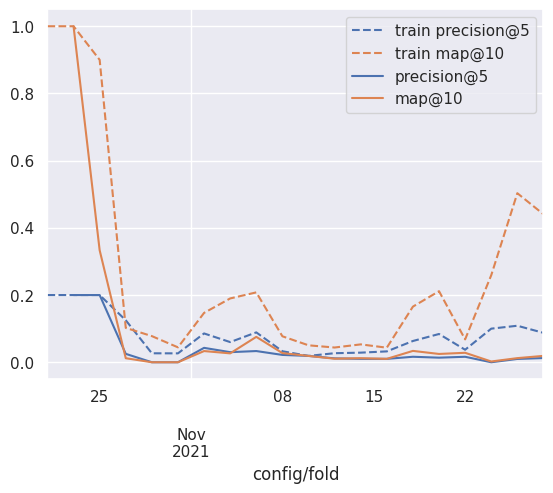

In [44]:
_toplot = best_realistic.copy().sort_index()
_toplot.index = pd.to_datetime(_toplot.index)

ax = best.reset_index().set_index('fold')[cols2plot].rename(columns='train {}'.format).plot(style='--', color=[l.get_color() for l in ax.lines])
# plt.xticks(range(10))
# bdf[cols2plot].rename(columns='baseline {}'.format).reset_index(drop=True).plot(ax=ax, style=':', color=[l.get_color() for l in ax.lines])

_toplot[cols2plot].plot(ax=ax)
# ax.set_ylim(0, 1)

_toplot[cols2plot].describe()

In [45]:
best_realistic.index.min()

Timestamp('2021-10-23 00:00:00')

In [46]:
bdf

,precision@1,precision@3,precision@5,precision@10,precision@15,precision@100,ndcg@1,ndcg@3,ndcg@5,ndcg@10,...,recall@10,recall@15,recall@100,r-precision@1,r-precision@3,r-precision@5,r-precision@10,r-precision@15,r-precision@100,time_eval
fold,,,,,,,,,,,,,,,,,,,,,
2022-06-16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.071717
2022-06-18,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.070396
2022-06-20,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069299
2022-06-22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069597
2022-06-24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069861
2022-06-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.071567
2022-06-28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.069569
2022-06-30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.068110
2022-07-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.068867


In [47]:
_PERFECT_NAME = 'Ground Truth'
_LEAK_NAME = 'Leaky GNN'
CAT_ORDER = [_PERFECT_NAME, _LEAK_NAME, 'GNN', 'OpenPop']

def _get_toplot_table(metrics2plot=cols2plot, oracle=True, perfect=None, common_only=False):
    if perfect is None:
        perfect = metrics2plot
    
    # _toplot = best_realistic.copy()
    # _toplot.index = pd.to_numeric(_toplot.index)
    # _toplot['fold'] = _toplot.index

    _first_real_fold_idx = best_realistic.index.min()
    
    _toplot_real = best_realistic[metrics2plot].copy()
    _toplot_real['fold'] = pd.to_datetime(_toplot_real.index) # .astype(int)
    _toplot_real['rec'] = 'GNN'

    _toplot_base = bdf[metrics2plot].copy()
    # fold2str = _toplot_base.index.strftime('%G-W%V')
    # _toplot_base['fold'] = range(len(_toplot_base))
    _toplot_base['fold'] = pd.to_datetime(_toplot_base.index)
    _toplot_base['rec'] = 'OpenPop'

    # _colsbest = map("best_{}".format, _cols)
    if oracle:
        _toplot_best = best.reset_index().set_index('fold')[metrics2plot].copy() # [_colsbest].rename(columns=lambda x: x.split("_", 1)[-1])
        _toplot_best['fold'] = _toplot_best.index
        _toplot_best['rec'] = _LEAK_NAME
    else:
        _toplot_best = None
        _toplot_base = _toplot_base[_toplot_base['fold'] >= _first_real_fold_idx]
        _toplot_real = _toplot_real[_toplot_real['fold'] >= _first_real_fold_idx]

    if perfect:
        _toplot_perfect = pdf[perfect].copy()
        _toplot_perfect['fold'] = pd.to_datetime(_toplot_perfect.index)
        _toplot_perfect['rec'] = _PERFECT_NAME
        # Make same len as baseline
        # _toplot_perfect = _toplot_perfect.iloc[-len(_toplot_base):]
        _toplot_perfect = _toplot_perfect.loc[_toplot_base.index]
        assert _toplot_perfect.index.equals(_toplot_base.index)
    else:
        _toplot_perfect = None
        
    _toplot = (
        pd.concat((
            _toplot_real, 
            _toplot_best,
            _toplot_base,
            _toplot_perfect,
        ), ignore_index=True)
        .melt(id_vars=['fold', 'rec'], value_vars=metrics2plot, var_name='metric')
    )

    assert pd.api.types.is_datetime64_any_dtype(_toplot['fold'].dtype), "Fold column should be datetime"
    assert not (_toplot['fold'].isna()).any()
    
    _toplot['rec'] = pd.Categorical(_toplot['rec'], CAT_ORDER)
    _toplot['fold_week'] = _toplot['fold'].dt.strftime('%G-W%V') # fold2str[_toplot['fold']]

    return _toplot.sort_values('fold')

_tablecols = ['precision@5', 'precision@10', 'recall@5', 'recall@10', 'map@5', 'map@10', 'ndcg@5', 'ndcg@10']
_table = _get_toplot_table(_tablecols)
# Skip the first fold so everyone has 9 folds and metrics are consistent
_table = _table[_table['fold'] >= best_realistic.index.min()]
print(_table.groupby(['rec', 'metric'])['value'].mean().unstack(level=-1)[_tablecols].rename(
    index={
        'Perfect': 'Ground Truth',
        'realistic': 'GNN'
    }
).style.format(precision=2).to_latex())
_table.groupby(['rec', 'metric']).describe()

\begin{tabular}{lrrrrrrrr}
metric & precision@5 & precision@10 & recall@5 & recall@10 & map@5 & map@10 & ndcg@5 & ndcg@10 \\
rec &  &  &  &  &  &  &  &  \\
Ground Truth & 0.35 & 0.35 & 0.12 & 0.25 & 0.35 & 0.35 & 0.35 & 0.35 \\
Leaky GNN & 0.08 & 0.05 & 0.29 & 0.33 & 0.24 & 0.24 & 0.26 & 0.27 \\
GNN & 0.04 & 0.03 & 0.13 & 0.14 & 0.09 & 0.09 & 0.10 & 0.11 \\
OpenPop & 0.00 & 0.00 & 0.00 & 0.00 & 0.00 & 0.00 & 0.00 & 0.00 \\
\end{tabular}



/tmp/ipykernel_3810641/3868849439.py:68: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

/tmp/ipykernel_3810641/3868849439.py:74: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



fold                                            \
                          count                 mean                  min   
rec          metric                                                         
Ground Truth map@10          20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             map@5           20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             ndcg@10         20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             ndcg@5          20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             precision@10    20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             precision@5     20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             recall@10       20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             recall@5        20  2022-07-05 00:00:00  2022-06-16 00:00:00   
Leaky GNN    map@10          19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             map@5           19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             ndcg@10         19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             ndcg@5          19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             precision@10    19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             precision@5     19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             recall@10       19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             recall@5        19  2021-11-10 00:00:00  2021-10-23 00:00:00   
GNN          map@10          19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             map@5           19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             ndcg@10         19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             ndcg@5          19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             precision@10    19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             precision@5     19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             recall@10       19  2021-11-10 00:00:00  2021-10-23 00:00:00   
             recall@5        19  2021-11-10 00:00:00  2021-10-23 00:00:00   
OpenPop      map@10          20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             map@5           20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             ndcg@10         20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             ndcg@5          20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             precision@10    20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             precision@5     20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             recall@10       20  2022-07-05 00:00:00  2022-06-16 00:00:00   
             recall@5        20  2022-07-05 00:00:00  2022-06-16 00:00:00   

                                                                     \
                                           25%                  50%   
rec          metric                                                   
Ground Truth map@10        2022-06-25 12:00:00  2022-07-05 00:00:00   
             map@5         2022-06-25 12:00:00  2022-07-05 00:00:00   
             ndcg@10       2022-06-25 12:00:00  2022-07-05 00:00:00   
             ndcg@5        2022-06-25 12:00:00  2022-07-05 00:00:00   
             precision@10  2022-06-25 12:00:00  2022-07-05 00:00:00   
             precision@5   2022-06-25 12:00:00  2022-07-05 00:00:00   
             recall@10     2022-06-25 12:00:00  2022-07-05 00:00:00   
             recall@5      2022-06-25 12:00:00  2022-07-05 00:00:00   
Leaky GNN    map@10        2021-11-01 00:00:00  2021-11-10 00:00:00   
             map@5         2021-11-01 00:00:00  2021-11-10 00:00:00   
             ndcg@10       2021-11-01 00:00:00  2021-11-10 00:00:00   
             ndcg@5        2021-11-01 00:00:00  2021-11-10 00:00:00   
             precision@10  2021-11-01 00:00:00  2021-11-10 00:00:00   
             precision@5   2021-11-01 00:00:00  2021-11-10 00:00:00   
             recall@10     2021-11-01 00:00:00  2021-11-10 00:00:00   
             recall@5      2021-11-01 00:00:00  2021-

/tmp/ipykernel_3810641/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3810641/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



count      mean       std       min       25%  \
rec          metric                                                       
Ground Truth map@10        20.0  0.350000  0.489360  0.000000  0.000000   
             precision@5   20.0  0.350000  0.489360  0.000000  0.000000   
Leaky GNN    map@10        20.0  0.279244  0.322483  0.043322  0.064317   
             precision@5   20.0  0.081643  0.060046  0.018868  0.031385   
GNN          map@10        19.0  0.088400  0.232715  0.000000  0.011277   
             precision@5   19.0  0.035386  0.059078  0.000000  0.010153   
OpenPop      map@10        20.0  0.000000  0.000000  0.000000  0.000000   
             precision@5   20.0  0.000000  0.000000  0.000000  0.000000   

                               50%       75%  max  
rec          metric                                
Ground Truth map@10       0.000000  1.000000  1.0  
             precision@5  0.000000  1.000000  1.0  
Leaky GNN    map@10       0.156237  0.304361  1.0  
             precision@5  0.073678  0.102160  0.2  
GNN          map@10       0.018958  0.030738  1.0  
             precision@5  0.016279  0.027500  0.2  
OpenPop      map@10       0.000000  0.000000  0.0  
             precision@5  0.000000  0.000000  0.0

Cannot show ipywidgets in text

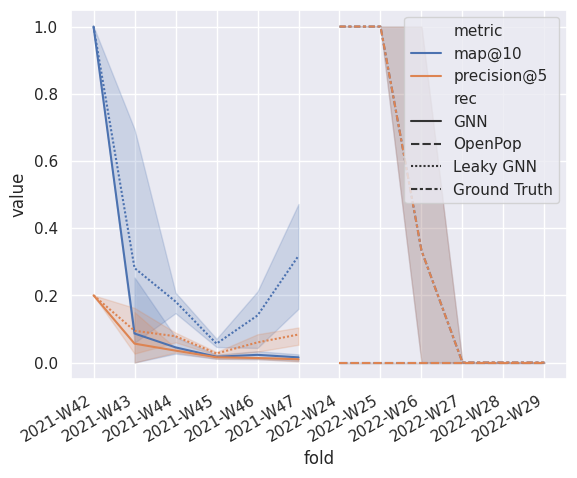

In [48]:
def plot_gnn_results(metrics2plot=cols2plot, oracle=False, perfect=None, common_only=False):
    _toplot = _get_toplot_table(metrics2plot, oracle, perfect)

    if common_only:
        _toplot = _toplot[_toplot['fold'] >= best_realistic.index.min()]

    ax = sns.lineplot(
        _toplot, x='fold_week', y='value', 
        hue='metric' if len(metrics2plot) > 1 else None, 
        style='rec',
        style_order=['GNN', 'OpenPop', _LEAK_NAME, _PERFECT_NAME],
    )
    ax.set_xlabel('fold')
    
    if len(metrics2plot) == 1:
        ax.set_ylabel(metrics2plot[0])
        ax.legend_.set_title(None)

    # ax.set_xticks(ax.get_xticks()[1:-1], _toplot_base.index.strftime('%G-W%V'), rotation=30, ha='right')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')

    display(_toplot.groupby(['rec', 'metric'])['value'].describe())
    # print(_toplot.groupby(['rec', 'metric'])['value'].describe()[['mean', 'std', '50%', 'min', 'max']].to_html())

    return ax

ax = plot_gnn_results(oracle=True) # perfect=['precision@5'])
download_matplotlib(ax.figure, '09_gnn_results.pdf')

/tmp/ipykernel_3810641/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3810641/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,20.0,0.350000,0.489360,0.0,0.000000,0.000000,1.0000,1.0
GNN,precision@5,19.0,0.035386,0.059078,0.0,0.010153,0.016279,0.0275,0.2
OpenPop,precision@5,20.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0000,0.0


Cannot show ipywidgets in text

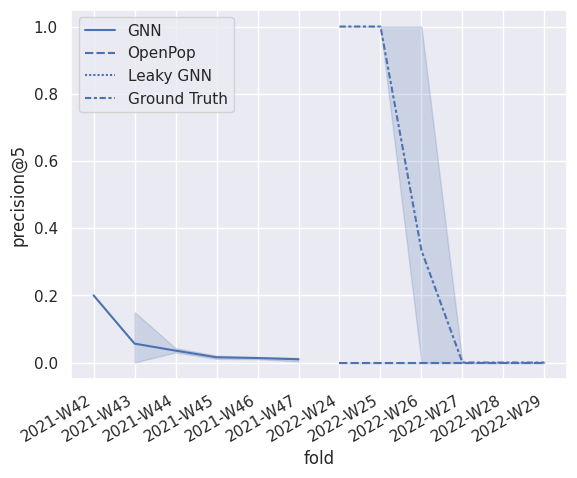

In [49]:
ax = plot_gnn_results(['precision@5'])
ax.figure.savefig('../figures/09_gnn_results_precision_5.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_precision_5.pdf')

/tmp/ipykernel_3810641/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3810641/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,precision@5,20.0,0.350000,0.489360,0.000000,0.000000,0.000000,1.000000,1.0
Leaky GNN,precision@5,19.0,0.075414,0.054650,0.018868,0.030447,0.063265,0.094444,0.2
GNN,precision@5,19.0,0.035386,0.059078,0.000000,0.010153,0.016279,0.027500,0.2
OpenPop,precision@5,20.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0


Cannot show ipywidgets in text

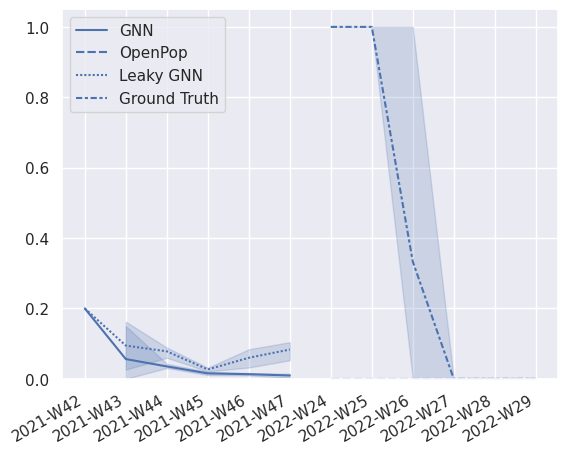

In [50]:
ax = plot_gnn_results(['precision@5'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_precision_5_leaky.pdf')

/tmp/ipykernel_3810641/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3810641/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,map@10,20.0,0.3500,0.489360,0.0,0.000000,0.000000,1.000000,1.0
GNN,map@10,19.0,0.0884,0.232715,0.0,0.011277,0.018958,0.030738,1.0
OpenPop,map@10,20.0,0.0000,0.000000,0.0,0.000000,0.000000,0.000000,0.0


Cannot show ipywidgets in text

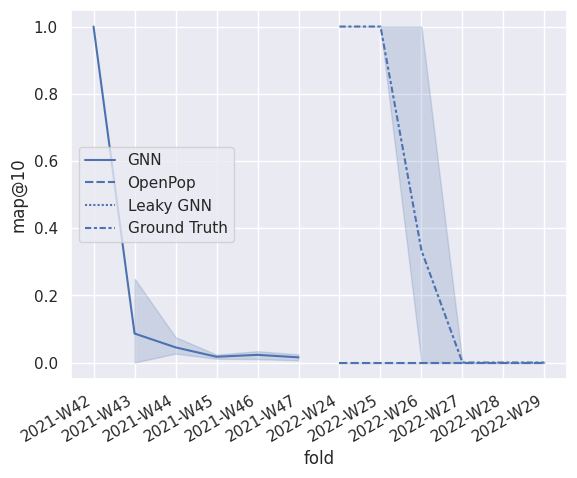

In [51]:
ax = plot_gnn_results(['map@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_map_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_map_10.pdf')

/tmp/ipykernel_3810641/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3810641/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,20.0,0.350000,0.489360,0.0,0.000000,0.000000,1.000000,1.0
GNN,ndcg@10,19.0,0.105671,0.242846,0.0,0.014572,0.029613,0.050002,1.0
OpenPop,ndcg@10,20.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0


Cannot show ipywidgets in text

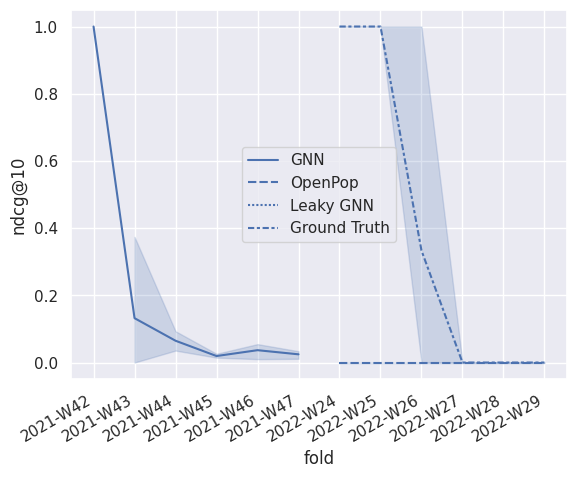

In [52]:
ax = plot_gnn_results(['ndcg@10']) #, perfect=False)
ax.figure.savefig('../figures/09_gnn_results_ndcg_10.png', bbox_inches='tight')
download_matplotlib(ax.figure, '09_gnn_results_ndcg_10.pdf')

/tmp/ipykernel_3810641/1512336908.py:20: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/tmp/ipykernel_3810641/1512336908.py:22: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,,count,mean,std,min,25%,50%,75%,max
rec,metric,,,,,,,,
Ground Truth,ndcg@10,20.0,0.350000,0.489360,0.000000,0.000000,0.000000,1.000000,1.0
Leaky GNN,ndcg@10,19.0,0.269941,0.278325,0.047985,0.075705,0.183532,0.296509,1.0
GNN,ndcg@10,19.0,0.105671,0.242846,0.000000,0.014572,0.029613,0.050002,1.0
OpenPop,ndcg@10,20.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0


Cannot show ipywidgets in text

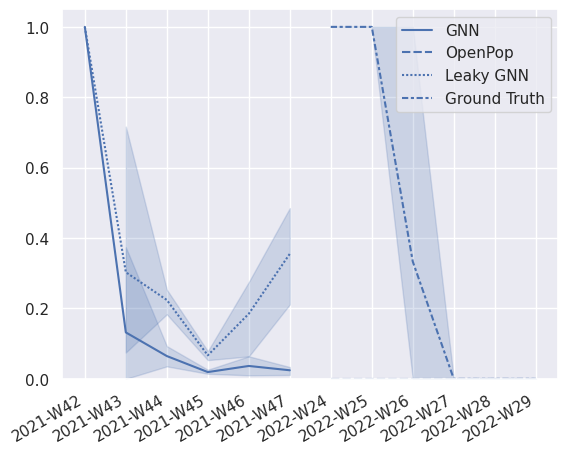

In [53]:
ax = plot_gnn_results(['ndcg@10'], oracle=True, common_only=True)

ax.set_xlabel('')
ax.set_ylabel('')
ax.set_ylim(0)

download_matplotlib(ax.figure, '09_gnn_results_ndcg_10_leaky.pdf')